In [1]:
import pandas as pd
import seaborn as sns
from utils import DATA_PATH, LIBRARY_IS_HEAVY_MAP, WT_LIBRARY_MAP, get_library
import matplotlib.pyplot as plt
import scipy as sp
from sklearn.preprocessing import OneHotEncoder
from sklearn.decomposition import TruncatedSVD
import numpy as np
import plotly.express as px

# Choose an antibody seed for further engineering

Engelhart et al. (2021) generated a dataset of antibody mutants vs binding affinity to a covid peptide. They did mutational scans on three seed chains (MIT_14, MIT_91, and MIT_95), and I'd like to choose a seed to advance for further engineering.


In [2]:
df = pd.read_csv(f"{DATA_PATH}/MITLL_AAlphaBio_Ab_Binding_dataset.csv")
# split out library prefix
df['Library'] = df['POI'].apply(get_library)
df

,POI,Sequence,Target,Assay,Replicate,Pred_affinity,HC,LC,CDRH1,CDRH2,CDRH3,CDRL1,CDRL2,CDRL3,Library
0,AAYL50_1332,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,MIT_Target,1,1,0.866129,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,DVVMTQSPESLAVSLGERATISCHSSQSVGYESRMKNSVAWYQQKA...,GFTLNSYGIS,VIYSDGRRTFYGDSVK,GRAAGTFDS,HSSQSVGYESRMKNSVA,WASTRES,QQYHRLPLS,AAYL50
1,AAYL50_20866,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,MIT_Target,1,1,1.450543,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,DVVMTQSPESLAVSLGERATISCKSSQSVLYESRNKVSVAWYQQKA...,GFTLNSYGIS,VIYSDGRRTFYGDSVK,GRAAGTFDS,KSSQSVLYESRNKVSVA,HANTRES,QQYHRLPLS,AAYL50
2,AAYL49_28,EVQLVETGGGLVQPGGSLRLSCAASNFTLQSYGISWVRQAPGKGPE...,MIT_Target,1,1,1.789996,EVQLVETGGGLVQPGGSLRLSCAASNFTLQSYGISWVRQAPGKGPE...,DVVMTQSPESLAVSLGERATISCKSSQSVLYESRNKNSVAWYQQKA...,NFTLQSYGIS,VIYSDGRRTFYGDSVK,GRAAGTFDS,KSSQSVLYESRNKNSVA,WASTRES,QQYHRLPLS,AAYL49
3,AAYL50_13317,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,MIT_Target,1,1,1.704217,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,DVVMTQSPESLAVSLGERATISCKSSQSVGYESRNKNSVAWYQQKA...,GFTLNSYGIS,VIYSDGRRTFYGDSVK,GRAAGTFDS,KSSQSVGYESRNKNSVA,VASTRAS,QQYHRLPLS,AAYL50
4,AAYL50_7657,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,MIT_Target,1,1,1.625471,EVQLVETGGGLVQPGGSLRLSCAASGFTLNSYGISWVRQAPGKGPE...,DVVMTQSPESLAVSLGERATISCKSSESVLYQSRNKNSVAWYQQKA...,GFTLNSYGIS,VIYSDGRRTFYGDSVK,GRAAGTFDS,KSSESVLYQSRNKNSVA,WASTRES,QAYHRLPLS,AAYL50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1259695,AAYL51_4283,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,AlphaNeg2,2,3,NaN,EVQLVESGGGLVQPGRSLRLSCAASGFTFDDYAMHWVRQAPGKGLE...,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,GFTFDDYAMH,GISWNSGSIGYAPSVK,VGRGGHYFDY,TLRSGINVGTYRIY,YKSDSDKQQGSGV,MIWHSSAWV,AAYL51
1259696,AAYL51_4283,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,AlphaNeg3,2,3,NaN,EVQLVESGGGLVQPGRSLRLSCAASGFTFDDYAMHWVRQAPGKGLE...,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,GFTFDDYAMH,GISWNSGSIGYAPSVK,VGRGGHYFDY,TLRSGINVGTYRIY,YKSDSDKQQGSGV,MIWHSSAWV,AAYL51
1259697,AAYL51_4284,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,AlphaNeg1,2,3,NaN,EVQLVESGGGLVQPGRSLRLSCAASGFTFDDYAMHWVRQAPGKGLE...,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,GFTFDDYAMH,GISWNSGSIGYAGSVK,VGRGGGIFDY,TLRSGINVGTYRIY,YKSDSDKQQGSGV,MIWHSSAWV,AAYL51
1259698,AAYL51_4284,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,AlphaNeg2,2,3,NaN,EVQLVESGGGLVQPGRSLRLSCAASGFTFDDYAMHWVRQAPGKGLE...,QAVLTQPSSLSASPGASVSLTCTLRSGINVGTYRIYWYQQKPGSPP...,GFTFDDYAMH,GISWNSGSIGYAGSVK,VGRGGGIFDY,TLRSGINVGTYRIY,YKSDSDKQQGSGV,MIWHSSAWV,AAYL51




The plot below compares `Pred_affinity` for WT (reddish boxplots) with mutant libraries (colored violin plots). This already gives some idea for which seed I'd like to advance for further engineering:
- 14 explores both HC and LC space, and seems to have good probability mass over WT affinity for its LC mutants (AAYL50). My biological intuition is that H and L chains won't interact much (also justified by the approach in [Li et al. 2022](https://www.biorxiv.org/content/10.1101/2022.10.07.502662v1.full.pdf)), and binding improvements in one aren't likely to cause some negative interaction in the other. Thus, this already seems like the safest candidate to advance by far.
- 91 shows the highest peak improvements over WT. But only the heavy chain space was explored in these experiments, and median performance is lowest. Also incorporation was lowest according to Table 2 in Engelhart. Possible moonshot candidate.
- 95 shows high variance in the WT measurement, low peak mutant performance, and low variance in mutant performance. That said, its median mutant performance is second highest, and it has almost complete incorporation coverage according to table 

So far seed MIT_14 is the top candidate for advancement.

<AxesSubplot: xlabel='Pred_affinity', ylabel='Library'>

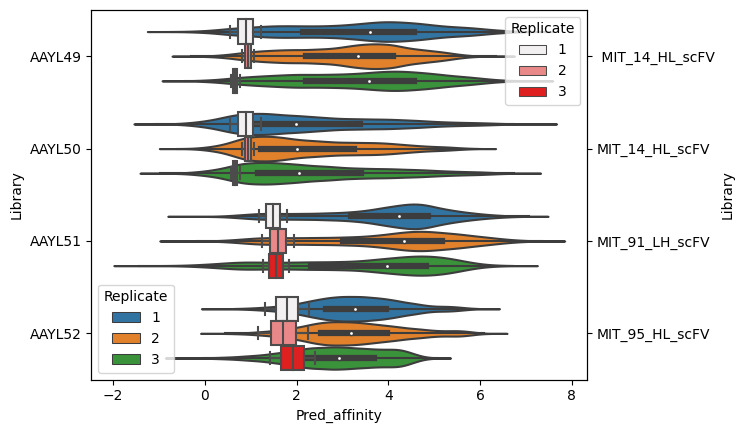

In [3]:
# Filter out negative samples
target_df = df[df['Target'] == "MIT_Target"].copy()
target_mutant = target_df[target_df['POI'].str.contains('MIT_') == False].sort_values('Library')
wt_df = target_df[target_df['POI'].str.contains('MIT_')]
wt14 = wt_df[wt_df['POI']=="MIT_14_HL_scFV"].copy()
wt14['Library'] = " MIT_14_HL_scFV"
wt_df = pd.concat([wt_df, wt14]).sort_values('Library')
min_affinity = target_df['Pred_affinity'].min()
ax = sns.violinplot(data=target_mutant, y='Library', x='Pred_affinity', hue='Replicate')
ax2 = ax.twinx()
sns.boxplot(data=wt_df, y='Library', x='Pred_affinity', hue='Replicate', color='red', ax=ax2)

There's a lot going on in the plots below. For each seed library I plot:
1. The bar plots shows the mean number of mutations at each CDR site. The three CDRs are concatenated together horizontally, CDR 1-3 left to right. The x-axis is the index of each site, restarting at `1` for each subsequent CDR. 
   1. The blue bars show mean number of designed mutations at each site. Engelhart designed a fairly even number of mutations at each site, so these bars are fairly even.
   2. However, only some of those designs actually got non-null `Pred_affinity` readings. The red bars show the mean number of mutations _with measured affinity_ at each site.
         - Affinity measurement dropout does not seem random. Sites where mutations had lots of NA value affinities are more "conserved" sites, e.g. residues around the start and end of the CDRs, where mutations tended to break affinity altogether. This is supporting evidence for Engelhart's suggestion that null affinity values signify very low affinity (high 'Pred_affinity')(See "Sequences without a pred_aff value.").
2. The violin plots show the number of mutations in a replicate (x-axis) vs the distribution of `Pred_affinity` values. The leftmost plot is 0 mutations (wild type), which also has a light blue horizontal line drawn across the entire plot for each WT data point.   
   - I've imputed a value of `8` (a little more than the max `Pred_affinity` found in the data) to all null `Pred_affinity` replicates here. The # of NA values increases with # mutations, which is more evidence that NAs occur non-randomly when binding is low.
  - For library 51 there's a clear batch effect between assays 1 & 2 when looking at WT strains. This batch effect is not present in other chains; more reason not to advance this chain for further scanning.
  - There may be differences between Assay 1 & 2 for each WT seed chain replicate, but we are comparing only two data points. I don't think normalizing for batch effects of assay makes sense, partially because the Std Dev of affinity between replicates is already quite high within assay (see the subsequent set of violin plots) .
- Immediately under each violinplot I've printed the pearson correlation of # of mutations with respect to `Pred_affinity`. A higher correlation indicates fragility: more mutations = worse fitness. 
   - 49 has the highest correlation, but 50 has the lowest correlation (both are seed MIT_14). Since using seed chain MIT_14 was my choice before, this is not enough to change my mind.



==================== AAYL49 =====================================


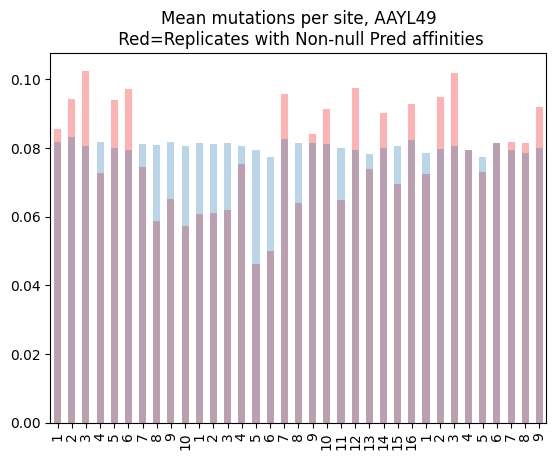

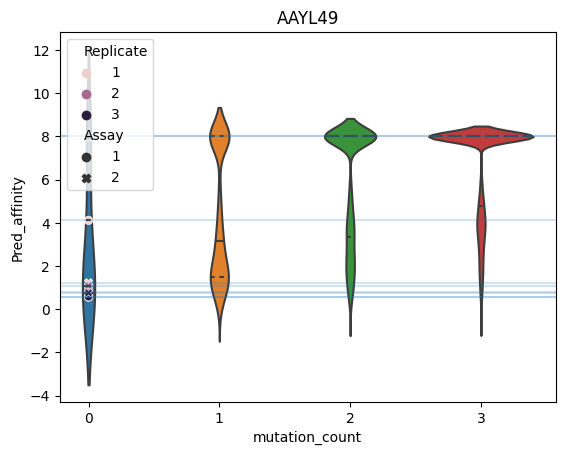

Pearson correlation: # mutations vs Pred_affinity.
 PearsonRResult(statistic=0.17128623377614402, pvalue=0.0)


==================== AAYL50 =====================================


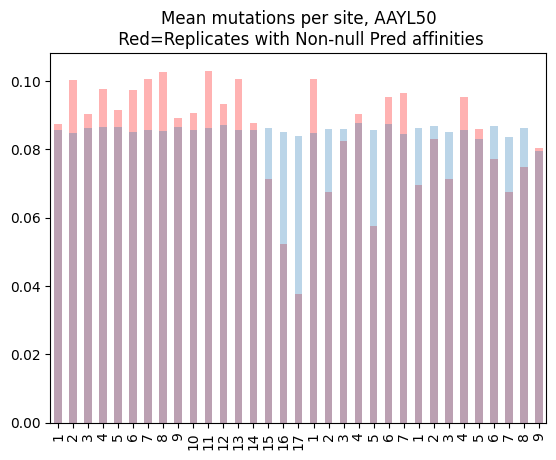

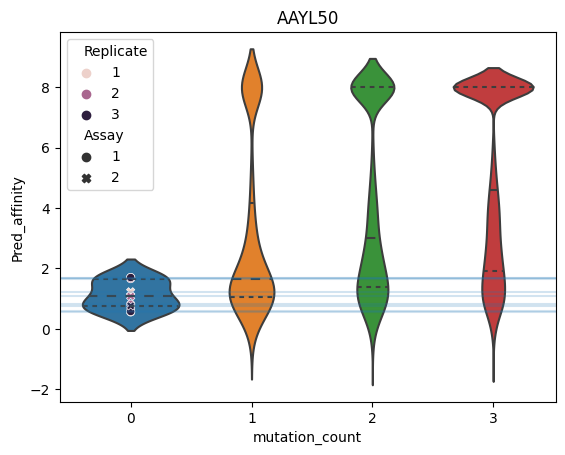

Pearson correlation: # mutations vs Pred_affinity.
 PearsonRResult(statistic=0.11712228040137523, pvalue=2.552523111552185e-238)


==================== AAYL51 =====================================


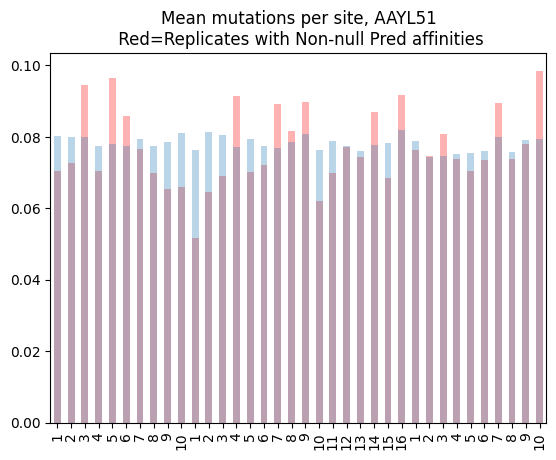

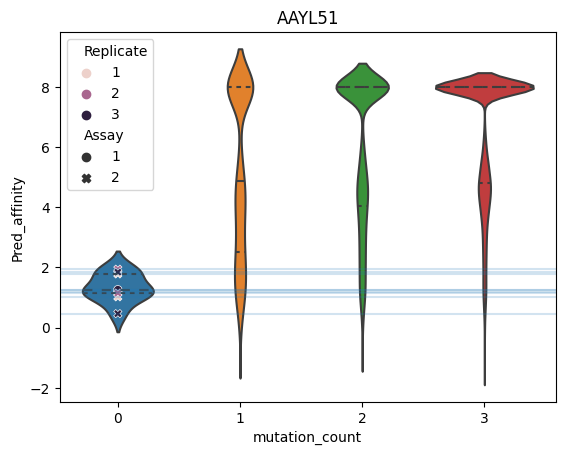

Pearson correlation: # mutations vs Pred_affinity.
 PearsonRResult(statistic=0.12235354665061972, pvalue=3.673504899412412e-223)


==================== AAYL52 =====================================


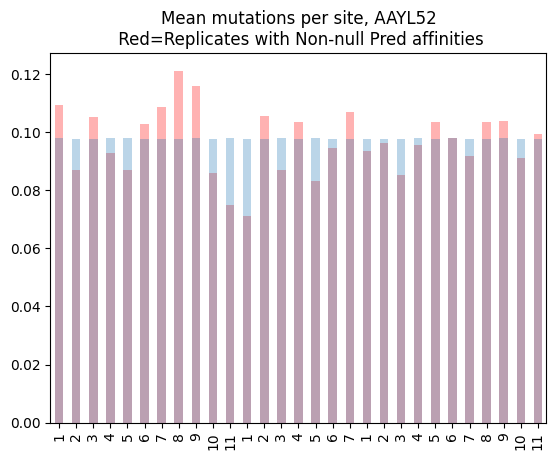

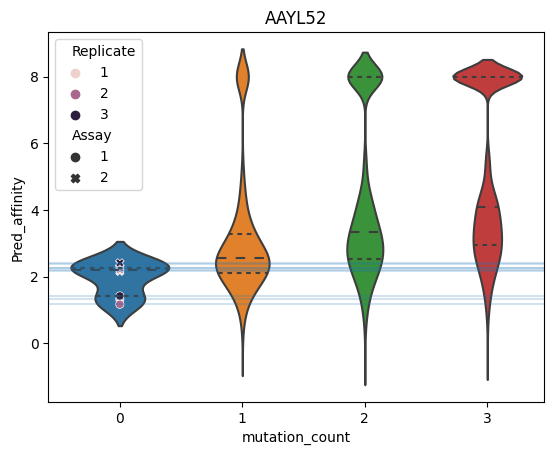

Pearson correlation: # mutations vs Pred_affinity.
 PearsonRResult(statistic=0.13796232001526587, pvalue=0.0)


In [4]:
# For each library generate a plot of # of mutations (compared to WT)
# across all three CDRs vs affinity (including WT affinity)
LIBRARY_AA_DF = {}
mutation_counts = []
for library in list(LIBRARY_IS_HEAVY_MAP.keys()):
    cdrs = []
    wts = []
    lib_data = target_df[
          (target_df['Library'] == library)
        | (target_df['Library'] == WT_LIBRARY_MAP[library])
        ].copy()
    # Merge all three cdr str
    for cdr_index in range(1,4):
        weight = "H" if LIBRARY_IS_HEAVY_MAP[library] else "L"
        cdr = f"CDR{weight}{cdr_index}"
        split_df = lib_data[cdr].str.split(pat ="\s*", expand = True).iloc[:,1:-1]  # type: ignore 
        cdrs.append(split_df)
    cdrs = pd.concat(cdrs, axis=1)
    LIBRARY_AA_DF[library] = cdrs
    wt_data = cdrs[lib_data['Library'] == WT_LIBRARY_MAP[library]]
    is_mutant = (cdrs != wt_data.head(1).values)
    is_mutant[lib_data['Pred_affinity'].notna()].mean().plot.bar(color='red', alpha=.3)
    is_mutant.mean().plot.bar(alpha=.3).set(title=f'Mean mutations per site, {library}\n Red=Replicates with Non-null Pred affinities')
    print("\n\n====================",library,"=====================================")
    plt.show()
    mutation_counts_per_replicate = is_mutant.T.sum()
    lib_data['mutation_count'] = mutation_counts_per_replicate 
    mutation_counts.append(mutation_counts_per_replicate)
    fig, ax = plt.subplots()
    lib_data = lib_data.fillna(8)
    sns.violinplot(data=lib_data, x='mutation_count', y='Pred_affinity',
        inner="quartile", ax=ax
    ).set(title=library)
    sns.scatterplot(
        data=lib_data[lib_data['mutation_count']==0], x='mutation_count', 
        y='Pred_affinity', hue='Replicate', style='Assay', ax=ax
    )
    lib_data[lib_data['mutation_count']==0]['Pred_affinity'].apply(lambda x: ax.axhline(x, alpha=.2)) # type: ignore    
    plt.show()
    print("Pearson correlation: # mutations vs Pred_affinity.\n",sp.stats.pearsonr(lib_data['mutation_count'], lib_data['Pred_affinity']))
# Add mutation count data to original full dataframe
mutation_count = pd.concat(mutation_counts)
target_df['mutation_count'] = mutation_count[~mutation_count.index.duplicated(keep='first')]

Below is set of histograms of standard deviation in affinity across replicates, binned by library.

- There is reasonably high variance in affinity across replicates. This should inform my modeling choices, as predictions should have some measure of uncertainty/variance. 

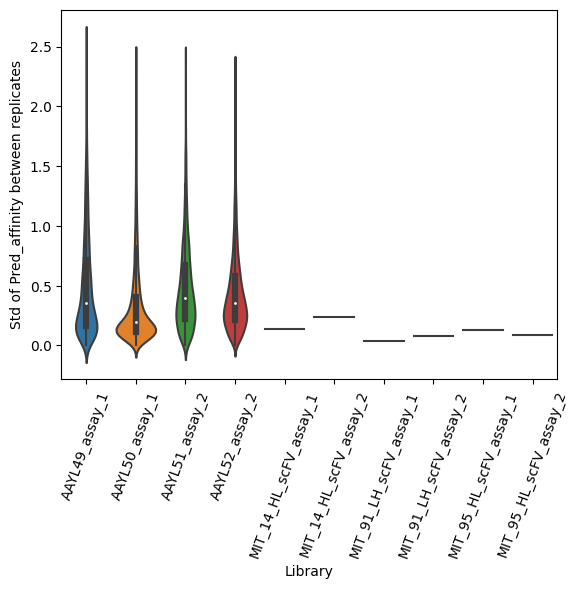

In [5]:
# Affinity variance across replicates for each library.
data = target_df.groupby(['POI', 'Library', 'Assay'])['Pred_affinity'].std().reset_index()
data['Library'] = data['Library'] + "_assay_" + data['Assay'].astype(str)
ax = sns.violinplot(data = data[['Library', 'Pred_affinity']], x='Library', y='Pred_affinity')
ax.set(ylabel='Std of Pred_affinity between replicates')
_ = plt.xticks(rotation=70)

According to Fig 2a in Engelhart, replicate reproducibly is also very high for library 50, and fairly high for library 49. Library 51 ranks about evenly with 49, and library 52 ranks last by a mile. Again, more evidence that we should advance seed chain 14.

Assuming we want to advance seed chain 14, according to the plots below there is a significant "batch" effect between replicates in its mutant libraries. I'm not sure why that would be, experimentally speaking, but we ought to account for this in modeling (I will skip this for simplicity for now.)

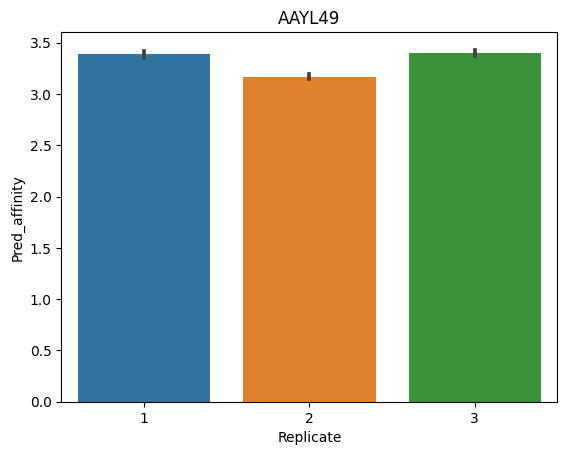

Text(0.5, 1.0, 'AAYL50')

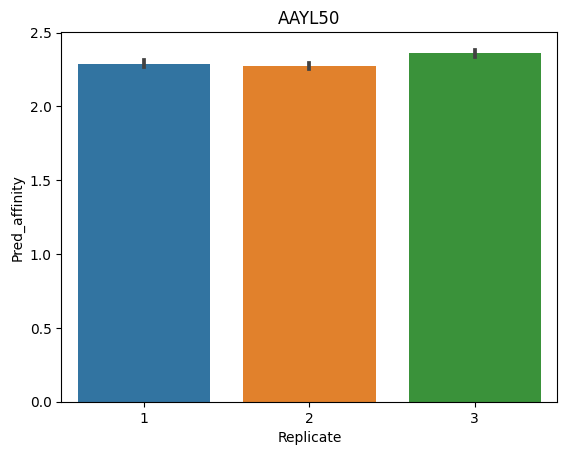

In [6]:
sns.barplot(data = target_df[target_df['Library']=='AAYL49'], x='Replicate', y='Pred_affinity').set_title("AAYL49")
plt.show()
sns.barplot(data = target_df[target_df['Library']=='AAYL50'], x='Replicate', y='Pred_affinity').set_title("AAYL50")

Below I performed truncated SVD on the samples from seed 14 and visualized either 2 or 3 dimensions. No patterns are obvious other than that the data is segregated by how many mutations it has from wild.

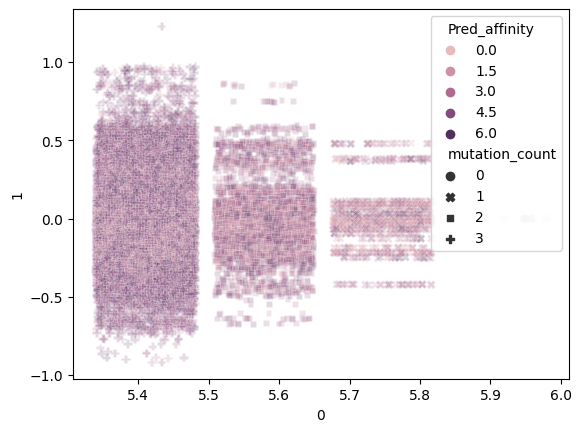

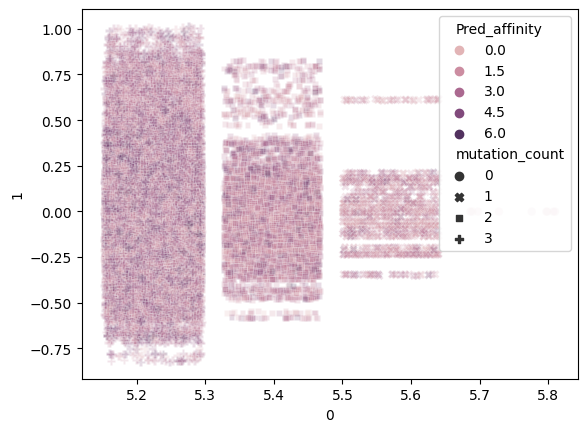

In [7]:
for lib in ['AAYL49',"AAYL50"]:
    enc = OneHotEncoder()
    one_hot_df = enc.fit_transform(LIBRARY_AA_DF[lib])
    tsvd = TruncatedSVD(n_components=3)
    reduced_df = tsvd.fit_transform(one_hot_df)
    reduced_df = pd.DataFrame(reduced_df, index=LIBRARY_AA_DF[lib].index)
    reduced_df['Pred_affinity'] = target_df['Pred_affinity'] 
    reduced_df['POI'] = target_df['POI'] 
    reduced_df['mutation_count'] = target_df['mutation_count'] 
    fig = px.scatter_3d(reduced_df, x=0, y=1, z=2,
                color='Pred_affinity')
    fig.show()

    # Add some jitter to the x axis
    reduced_df[0] = reduced_df[0] + pd.Series(np.random.uniform(-.07,.07, size=reduced_df.shape[0] ), index=reduced_df.index)
    sns.scatterplot(data=reduced_df, x=0, y=1, hue='Pred_affinity', style='mutation_count', alpha=.2)
    plt.show()


_Is this a “good” dataset of the local affinity fitness landscapes for these antibodies?_

Based on the above exploration, and on reading Engelhart, yes this does seem like a good dataset for machine learning. They did a thorough scan of the fitness landscape around wildtype, with fitness that ranges continuously and densely from "broken" to significantly improved.

I feel very confident in training a model on this data. Another quick test (that I performed in the Fitness Modeling notebook) is that a simple linear model with one-hot encoded features got an R2 of .16, which (though low) is also significantly positive. This shows learning promise. 

However given their max mutations was k=3, I would not be that confident in a model's ability to extrapolate much further.

Another quibble is that this dataset feels very conservative. Zero-shot learners might have been able do enough filtering to weed out many low-quality mutants, which can greatly improve model training efficiency according to [Wittmann et al. 2020](https://www.biorxiv.org/content/10.1101/2020.12.04.408955v1.full.pdf)

Also, a huge amount of the experimental bandwidth was dedicated to negative controls. I understand the value here, and I'm also not an expert in this assay, but I would not be surprised if a more aggressive use of bandwidth could be possible (e.g. even just doing two or one negative control instead of three).

For Engelhart's purposes, this conservative approach probably makes sense, but in a company setting I'm not so sure.
